In [ ]:
import cv2
import numpy as np
from PIL import Image
import plotly.graph_objects as go

In [90]:
def apply_wls_filter(disparity, img_left, img_right, stereo_matcher, lambda_val=8000, sigma=1.5):
    """Apply WLS filter for edge-aware smoothing"""
    right_matcher = cv2.ximgproc.createRightMatcher(stereo_matcher)
    
    disparity_right = right_matcher.compute(img_right, img_left).astype(np.float32) / 16.0
    
    wls_filter = cv2.ximgproc.createDisparityWLSFilter(stereo_matcher)
    wls_filter.setLambda(lambda_val)
    wls_filter.setSigmaColor(sigma)
    
    return wls_filter.filter(disparity, img_left, disparity_map_right=disparity_right)

def visualize_disparity(disparity, reference_img, colormap=cv2.COLORMAP_INFERNO):
    """Convert disparity to colormap and create side-by-side visualization"""
    # Mask invalid disparities
    disparity_viz = disparity.copy()
    disparity_viz[disparity < 0] = 0
    
    # Normalize to 0-255
    disp_uint8 = cv2.normalize(disparity_viz, None, 0, 255, cv2.NORM_MINMAX, dtype=cv2.CV_8U)
    
    # Apply colormap
    disp_color = cv2.applyColorMap(disp_uint8, colormap)
    disp_color_rgb = cv2.cvtColor(disp_color, cv2.COLOR_BGR2RGB)
    
    # Create side-by-side comparison
    h, w = reference_img.shape[:2]
    combined = Image.new('RGB', (2 * w, h))
    combined.paste(Image.fromarray(reference_img), (0, 0))
    combined.paste(Image.fromarray(disp_color_rgb), (w, 0))
    
    return combined, disp_uint8

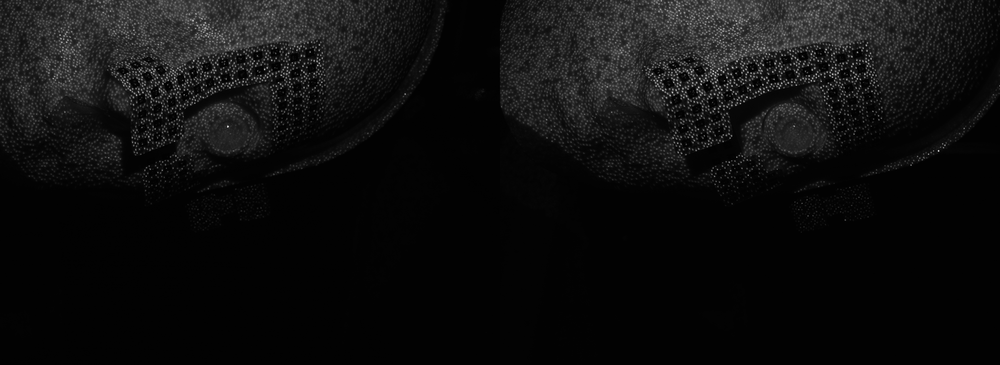

In [91]:
path = 'C:\\Github\\FSR_DLNR\\face_laser_projector\\'
number = '00000'
path1 = path + number + '_left.jpg'
path2 = path + number + '_right.jpg'

# Read as grayscale
img1 = cv2.imread(path1, cv2.IMREAD_GRAYSCALE)
img2 = cv2.imread(path2, cv2.IMREAD_GRAYSCALE)

# Convert from OpenCV (NumPy arrays) to PIL images
img1_pil = Image.fromarray(img1)
img2_pil = Image.fromarray(img2)

# combine 
w, h = img1_pil.size
combined = Image.new('L', (2 * w, h)) 
combined.paste(img1_pil, (0, 0))
combined.paste(img2_pil, (w, 0))
display(combined)

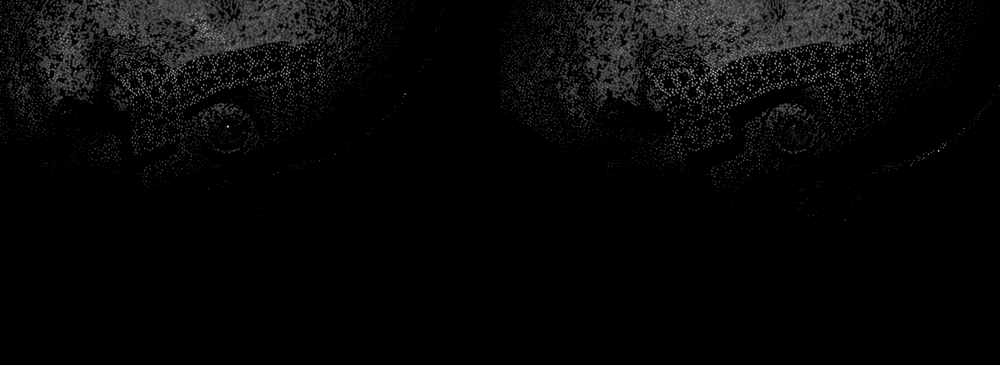

In [92]:
# --- Create brightness mask ---
# adjust threshold (e.g., 50–100) depending on your lighting
threshold = 40
mask1 = np.uint8(img1 > threshold) * 255
mask2 = np.uint8(img2 > threshold) * 255

# clean up masks using morph operators
kernel = np.ones((3, 3), np.uint8)
mask1 = cv2.morphologyEx(mask1, cv2.MORPH_OPEN, kernel)
mask2 = cv2.morphologyEx(mask2, cv2.MORPH_OPEN, kernel)

# --- Apply mask: keep only bright pixels ---
img1_masked = cv2.bitwise_and(img1, img1, mask=mask1)
img2_masked = cv2.bitwise_and(img2, img2, mask=mask2)

# Convert from OpenCV (NumPy arrays) to PIL images
img1_pil = Image.fromarray(img1_masked)
img2_pil = Image.fromarray(img2_masked)

# combine 
w, h = img1_pil.size
combined = Image.new('L', (2 * w, h)) 
combined.paste(img1_pil, (0, 0))
combined.paste(img2_pil, (w, 0))
display(combined)

In [259]:
h, w = img1.shape
scale = 1024 / min(h, w)
new_w, new_h = int(w * scale), int(h * scale)
img1_resize = cv2.resize(img1, (new_w, new_h), interpolation=cv2.INTER_AREA)
img2_resize = cv2.resize(img2, (new_w, new_h), interpolation=cv2.INTER_AREA)

clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))
img1_resize = clahe.apply(img1_resize)
img2_resize = clahe.apply(img2_resize)

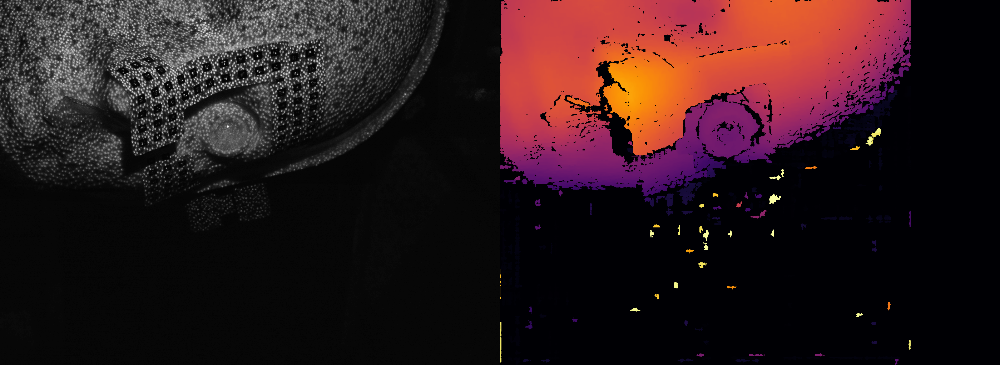

In [291]:
block_size = 9
min_disp   = -250
max_disp   = -50
num_disp = max_disp - min_disp
block_factor = 1

stereo = cv2.StereoSGBM.create(
    minDisparity      = min_disp,
    numDisparities    = num_disp,
    blockSize         = block_size,
    P1                = int(8 * block_factor * block_size**2),
    P2                = int(32 * block_factor * block_size**2),
    disp12MaxDiff     = 0,
    uniquenessRatio   = 12,
    speckleWindowSize = 100,
    speckleRange      = 1,
    mode              = 3,
)

# compute disparity and depth map
disparity = stereo.compute(img1_resize, img2_resize).astype(np.float32) / 16.0

# mask valid values
valid_mask = disparity > min_disp
disp_valid_only = np.where(valid_mask, disparity, np.nan)

# normalize ignoring NaNs
min_valid = np.nanmin(disp_valid_only)
max_valid = np.nanmax(disp_valid_only)
disp_norm = (disp_valid_only - min_valid) / (max_valid - min_valid)
disp_norm = np.nan_to_num(disp_norm, nan=0)
disp_uint8 = (disp_norm * 255).astype(np.uint8)

# display
combined_viz, _ = visualize_disparity(disp_uint8, img1_resize)
display(combined_viz)

In [ ]:
q = np.load("face_laser_projector/disp_to_depth_mat.npy")
assert q.shape == (4,4)
reproj = cv2.reprojectImageTo3D(disp_full, q, handleMissingValues=True)

NameError: name 'disp' is not defined

In [ ]:
x, y, z = points[:,0], points[:,1], -points[:,2]
cx, cy, cz = np.mean(x), np.mean(y), np.mean(z)
r = max(np.ptp(x), np.ptp(y), np.ptp(z)) / 2 

fig = go.Figure(data=[go.Scatter3d(
    x=x, y=y, z=z,
    mode='markers',
    marker=dict(size=2, color=intensity, colorscale='gray', opacity=0.9)
)])

fig.update_layout(
    scene=dict(
        xaxis=dict(range=[cx - r, cx + r]),
        yaxis=dict(range=[cy - r, cy + r]),
        zaxis=dict(range=[cz - r, cz + r]),
        aspectmode='cube' 
    ),
    margin=dict(l=0, r=0, t=0, b=0)
)

fig.show()